# Ensemble prediction for difficult tiles.

This version is only for models in .pth format.  
It is possible to use different models with differenf image sizes (image size must be multiple of 32).  
For Triton you need to use different servers for each size and model.  

 - To find a burned-out area with a minimum error in difficult cases (early spring, late autumn, smoke, clouds), you can use ensembles of several models with different image sizes.
 - The size must be a multiple of 32 and not bigger than the minimum dimention of tile.
 - If the sizes are not correct, the function will automatically recalculate them.
 - Using an ensemble of models and different sizes increases the prediction time, but decreases the error probability.

### [Single tile example](#single)
 - Example of single tiile processing.

### [Batch processing - tiles from test region](#batch)
 - Batch processing example.

For tiles with fire and smoke model2 and model5 work better.


 - Для нахождения выгоревшей территории с минимальной ошибкой в сложных случаях (ранняя весна, поздняя осень, дым, облака) можно использовать ансамбли из моделей с разным размером изображений.
 - Размер должен быть кратен 32 и не превышать минимальный размер тайла.
 - Если размеры указаны не правильно, функция автоматически их пересчитает.
 - Использование ансамбля моделей увеличивает время предсказания, но уменьшает вероятность ошибки. 

In [1]:
import glob
import os
import shutil

import matplotlib.pyplot as plt
import numpy as np
from IPython.core.interactiveshell import InteractiveShell
from tqdm import tqdm

from utils.detect import *
from utils.ensemble_prediction import *

InteractiveShell.ast_node_interactivity = "all"

In [2]:
CHANELS = ["B11", "B08", "B02"]
DEVICE = "cuda"
MAX_BATCH_SIZE = 8 # according to time calculation, there is no point in making batch bigger than 8, it works faster than other sizes
TIFF_PATH = [x.replace('response.tiff','') for x in glob.glob("/app/data/test_tiff/*/*.tiff")]
MODEL_PATHS = sorted(glob.glob("/app/models/*.pth"))
print(f"Model names: {[x.split('/')[-1].split('.')[0] for x in MODEL_PATHS]}")

Model names: ['model1', 'model2', 'model3', 'model4', 'model5', 'model6', 'model7']


In [3]:
models = []
for i in range(len(MODEL_PATHS)):
    model, device = get_torch_model(model_path=MODEL_PATHS[i], device=DEVICE)
    models.append(model)

Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda
Using device: cuda


<a id='single'></a>

## Single tile example

In [4]:
INTERSECTIONS = [0.2, 0.15, 0.1]
IMG_SIZES = [384, 512, 1024]
MODEL_NUMBERS = [1, 2, 3, 4, 5, 6, 7]
MASK_THRESHOLD = 0.999
AREA_THRESHOLD = 500

In [5]:
single_path = TIFF_PATH[27]
ds = get_dataset(path=single_path)
dict_meta = get_meta(path=single_path)

In [6]:
%%time
total_mask, list_masks, img, img_sizes = ensemble_predict(
    path=single_path,
    list_models=models,
    single_threshold=MASK_THRESHOLD,
    intersections=INTERSECTIONS,
    img_sizes=IMG_SIZES,
    norm=True,
    model_numbers=MODEL_NUMBERS,
    device="cuda",
    return_image=True,
    max_batch_size=MAX_BATCH_SIZE,
    disable_rasterio_warning=True,
)

CPU times: user 18.2 s, sys: 2.21 s, total: 20.4 s
Wall time: 11 s


In [7]:
thresholds = [ 5, 6, 7, 8, 9, 10, 11, 12] 
if thresholds == []:
    median_threshold = len(MODEL_NUMBERS) * len(IMG_SIZES) // 2
    delta_threshold = median_threshold // 2
    thresholds = list(
        range(
            median_threshold - delta_threshold, median_threshold + delta_threshold + 2
        )
    )
thresholds

[5, 6, 7, 8, 9, 10, 11, 12]

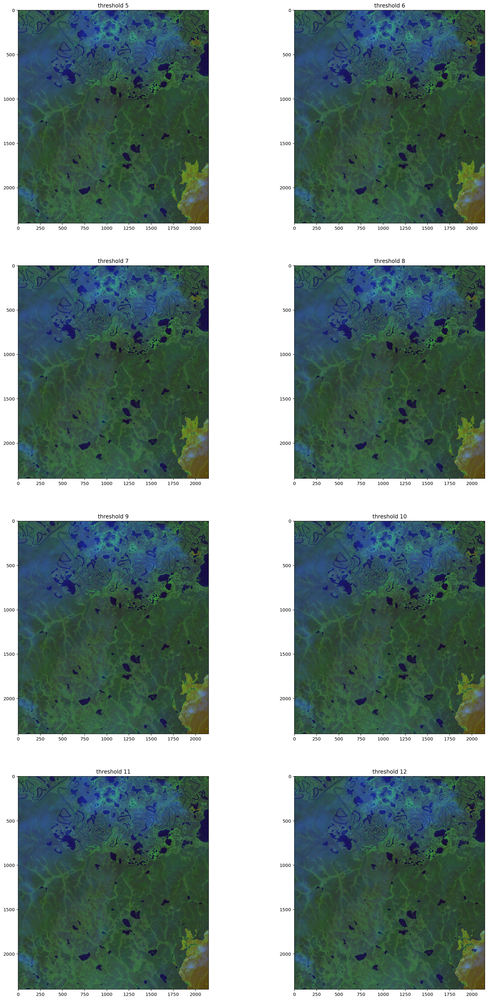

In [8]:
plot_ensemble_prediction(
    img=img,
    mask=total_mask,
    list_masks=list_masks,
    thresholds=thresholds,
)

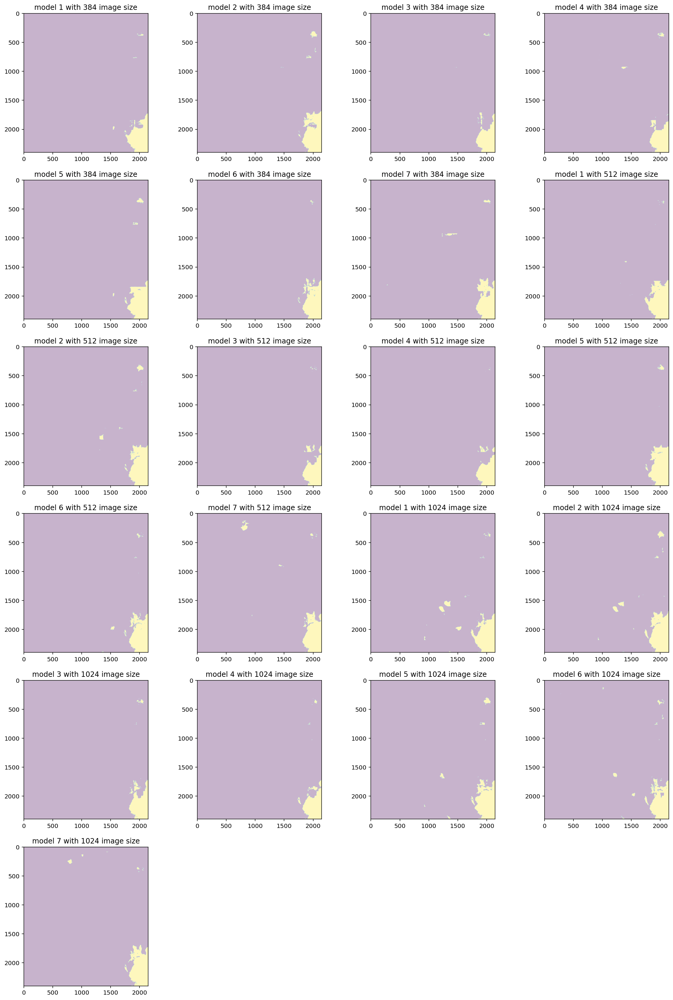

In [9]:
plot_ensemble_masks(
    list_masks=list_masks, model_numbers=MODEL_NUMBERS, img_sizes=img_sizes
)

In [10]:
ENSEMBLE_THRESHOLD = 12

In [11]:
mask = np.where(total_mask > ENSEMBLE_THRESHOLD, 1, 0)

In [12]:
%%time
all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
list_big_polygons = area_filter(all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD)
img_coord = [
    all_img_coord[i] for i in range(len(all_img_coord)) if i in list_big_polygons
]
img_polygons = coordinates_to_polygons(coordinates=img_coord)
geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
list_true_polygons, list_holes = detect_holes(
    img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
)
approximate_geo_polygons = coordinates_to_polygons(
    coordinates=[geo_coord[x] for x in list_true_polygons]
)

dict_polygons = detect_inner_polygons(
    img_polygons=img_polygons,
    list_true_polygons=list_true_polygons,
    list_holes=list_holes,
)
geo_polygons = make_geo_polygons(
    dict_inner_polygons=dict_polygons,
    geo_coordinates=geo_coord,
    list_true_polygons=list_true_polygons,
)

CPU times: user 289 ms, sys: 15.3 ms, total: 304 ms
Wall time: 302 ms


Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


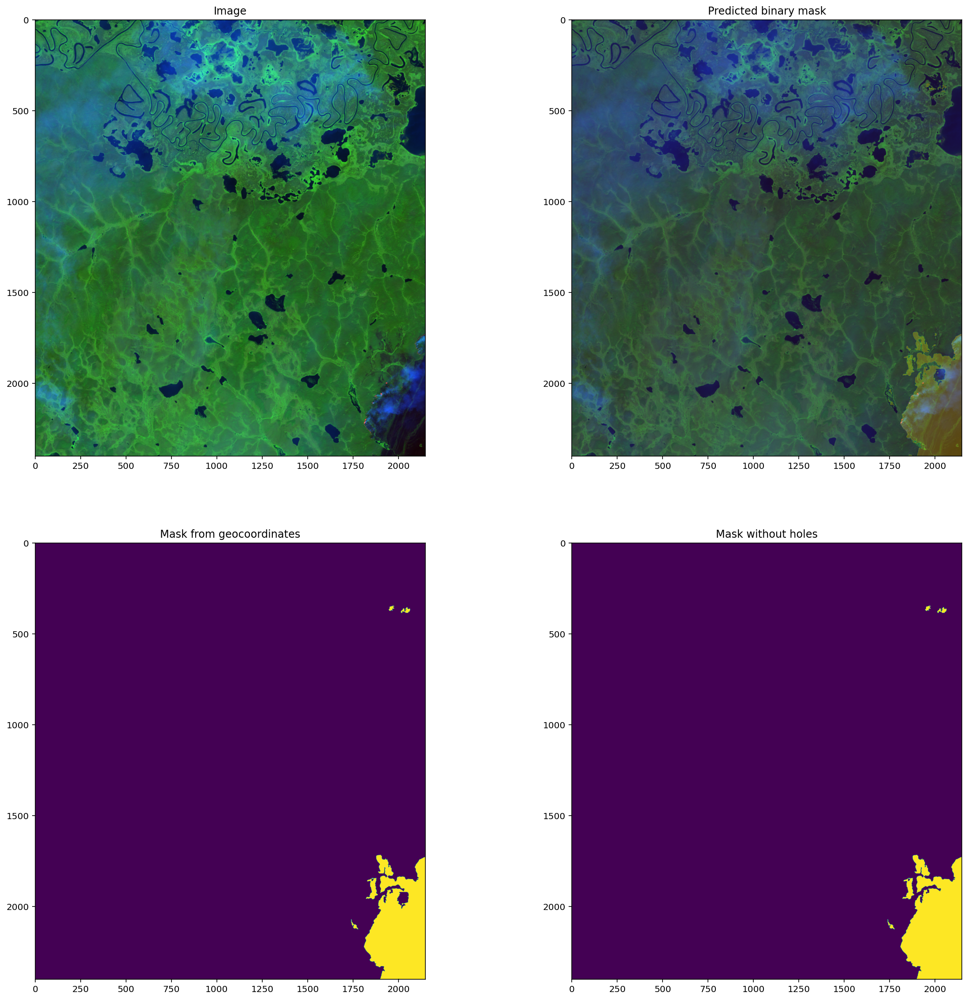

In [13]:
plot(
    image=img,
    binary_mask=mask,
    geo_polygons=geo_polygons,
    rasterio_dataset=ds,
    approx_polygons=approximate_geo_polygons,
)

<a id='batch'></a>

## Batch processing - tiles from test region

In [14]:
TEST_REGION_PATH = glob.glob("/app/data/ig_tiff_21/*/")
INTERSECTIONS = [0.2, 0.2]
MAX_BATCH_SIZE = 8
IMG_SIZES = [384, 1024] #size 1024 is bigger than image size, it will be recalculated
MODEL_NUMBERS = [1, 2, 3, 4, 5, 6, 7]
ENSEMBLE_THRESHOLD = 12
AREA_THRESHOLD = 100
MASK_THRESHOLD = 0.999

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


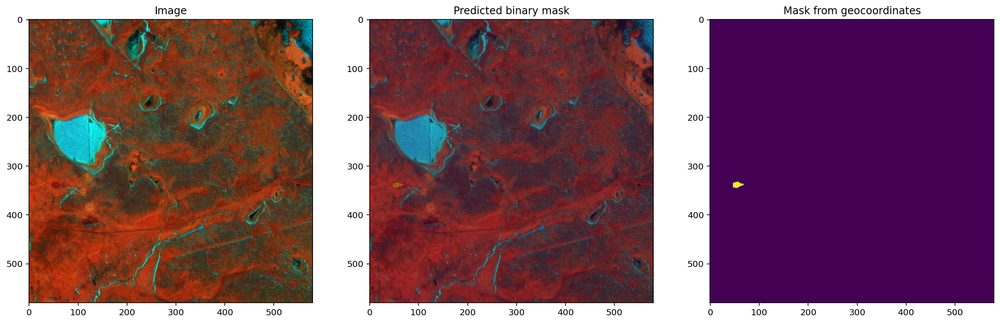

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


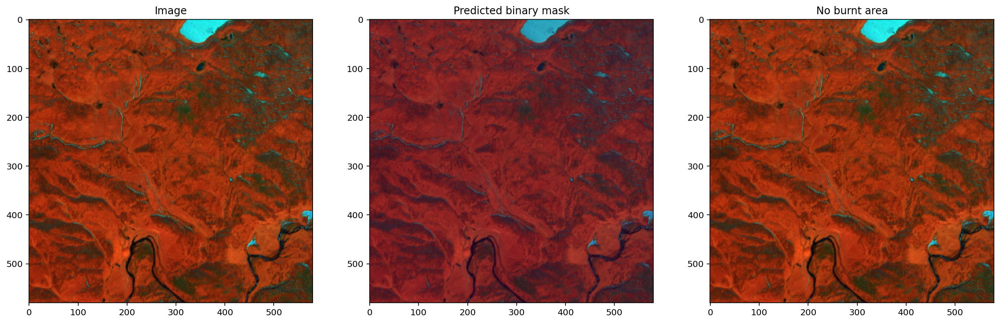

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


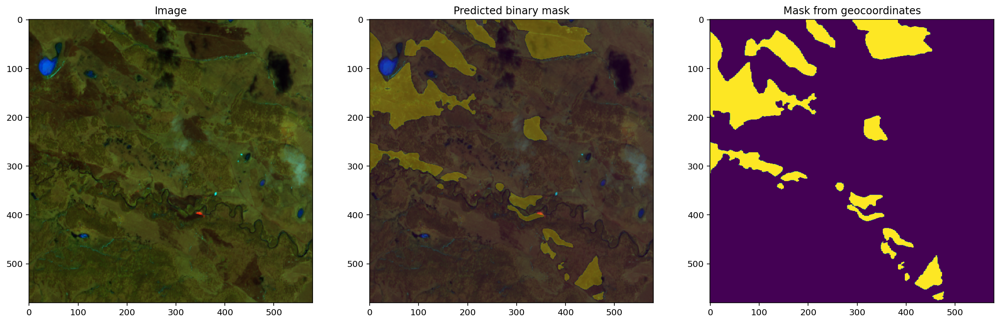

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


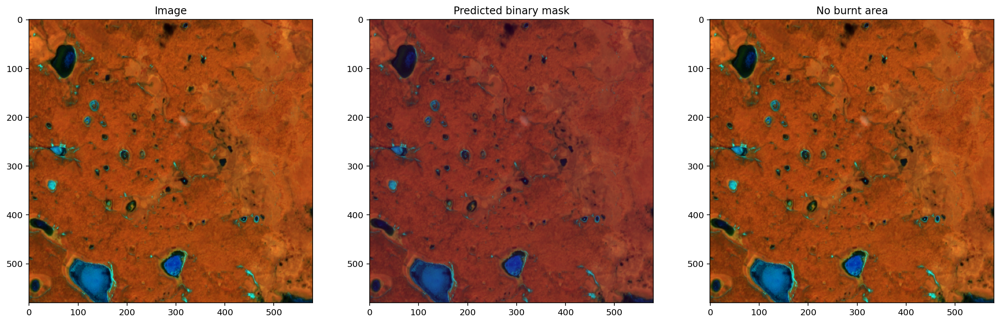

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


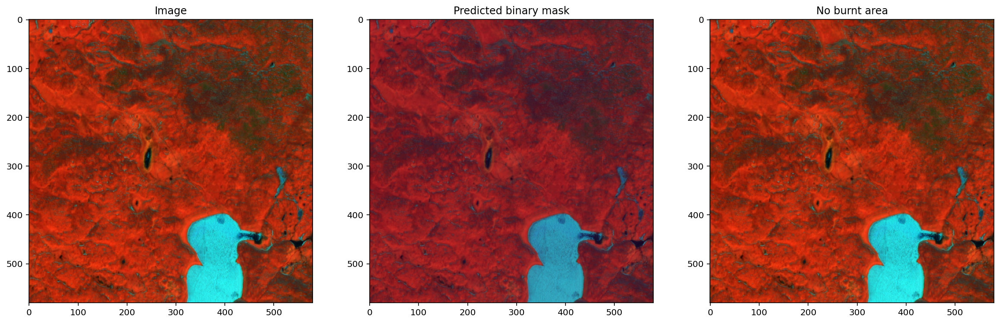

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


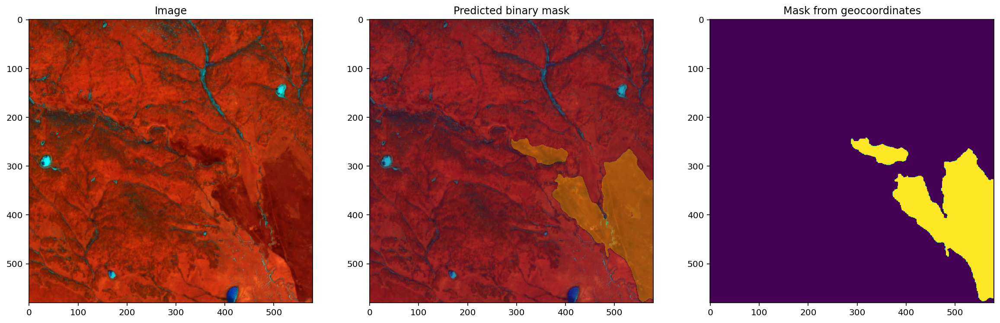

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


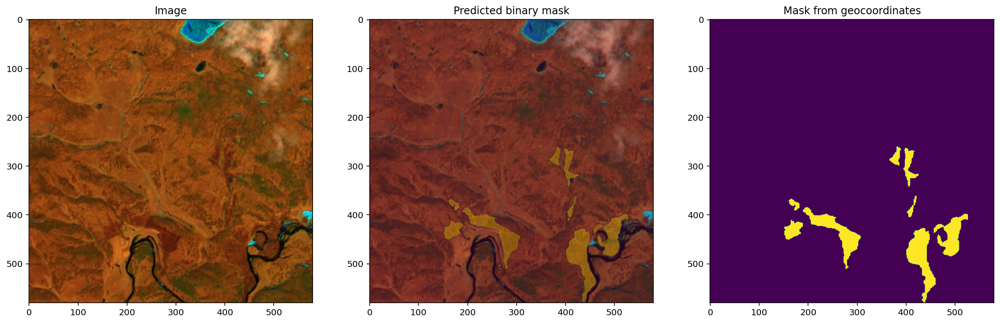

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


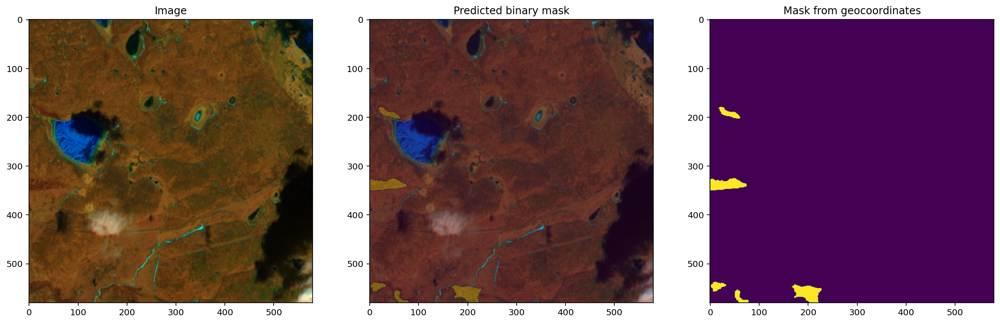

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


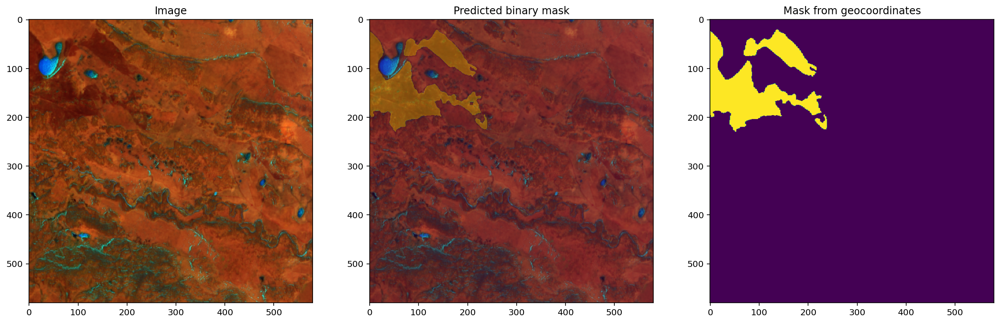

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


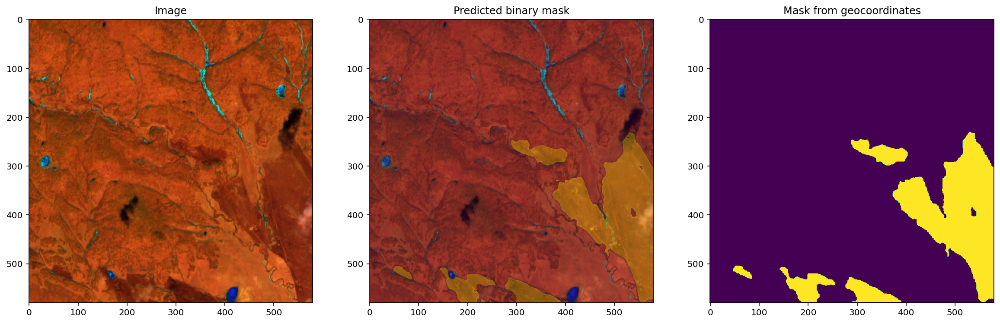

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


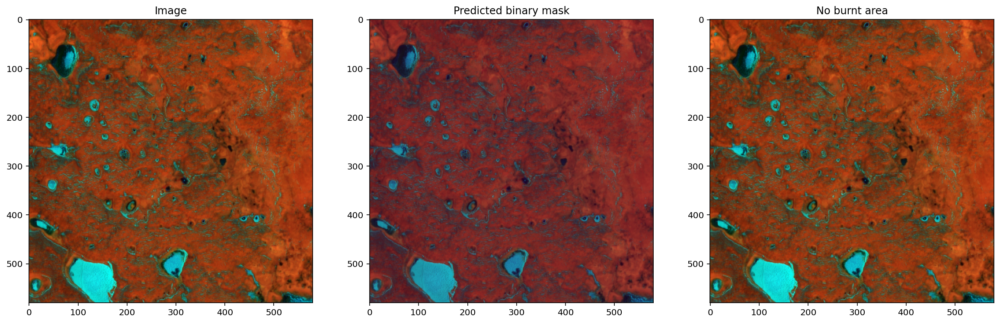

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


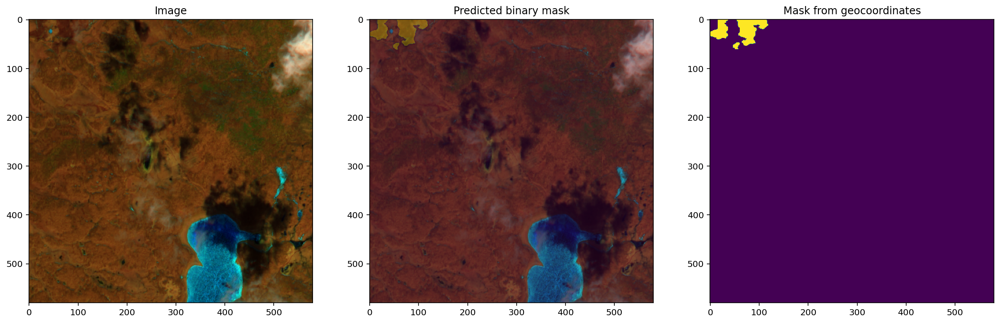

CPU times: user 46.2 s, sys: 3.48 s, total: 49.7 s
Wall time: 30.8 s


In [15]:
%%time
for single_path in TEST_REGION_PATH:
    ds = get_dataset(path=single_path)
    dict_meta = get_meta(path=single_path)
    total_mask, _, img, img_sizes = ensemble_predict(
        path=single_path,
        list_models=models,
        single_threshold=MASK_THRESHOLD,
        intersections=INTERSECTIONS,
        img_sizes=IMG_SIZES,
        norm=True,
        model_numbers=MODEL_NUMBERS,
        device="cuda",
        return_image=True,
        max_batch_size=MAX_BATCH_SIZE,
        disable_rasterio_warning=False,
    )
    mask = np.where(total_mask >= ENSEMBLE_THRESHOLD, 1, 0)
    all_img_coord = mask_to_polygon_coordinates(binary_mask=mask)
    all_img_polygons = coordinates_to_polygons(coordinates=all_img_coord)
    list_big_polygons = area_filter(
        all_img_polygons=all_img_polygons, area_threshold=AREA_THRESHOLD
    )
    img_coord = [
        all_img_coord[i] for i in range(len(all_img_coord)) if i in list_big_polygons
    ]
    img_polygons = coordinates_to_polygons(coordinates=img_coord)
    geo_coord = get_geo_coordinates(rasterio_dataset=ds, img_coordinates=img_coord)
    list_true_polygons, list_holes = detect_holes(
        img_polygons=img_polygons, predicted_mask=mask, buffer_pixels=2
    )
    approximate_geo_polygons = coordinates_to_polygons(
        coordinates=[geo_coord[x] for x in list_true_polygons]
    )

    dict_polygons = detect_inner_polygons(
        img_polygons=img_polygons,
        list_true_polygons=list_true_polygons,
        list_holes=list_holes,
    )
    geo_polygons = make_geo_polygons(
        dict_inner_polygons=dict_polygons,
        geo_coordinates=geo_coord,
        list_true_polygons=list_true_polygons,
    )
    plot(
        image=img,
        binary_mask=mask,
        geo_polygons=geo_polygons,
        rasterio_dataset=ds,
        approx_polygons=None,
    )
    plt.show()

___

IMG_SIZES = [384, 1024]  
INTERSECTIONS = [0.2, 0.2]  
Since image size for model prediction 1024 is bigger than tile size it was recalculated into 544:

In [16]:
img_sizes

[384, 544]

 - For those tiles for ensemble prediction the mean time is 9.29s for 12 tiles, it is 0.774s per tile.
 - For one model and one size (384x384) mean time is 1.43s for 12 tiles, it is 0.119s per tile.
 - With 7 models and 2 sizes time is 6.5 bigger.